## Vital Elements of Calculus Series

# Part 3: Derivative equations and Automatic Differentation 

In the previous post we talked about derivatives of a function that takes in a single input, at a single point.  We then saw how to quickly whip up a way to compute numerical derivatives across entire input spaces.  This approach - called Numerical Differentiation - while simple to build it was unfortunately generally unstable and at potentially innacurate depending on the input function.

In this post we explore how we can derive formulae for the derivatives of generic functions constructed from elementary functions/operations, which has far-reaching and very positive consequences for the effective computing of derivatives.

In [1]:
# imports from custom library
import sys
sys.path.append('../../')
import numpy as np
import matplotlib.pyplot as plt
from mlrefined_libraries import calculus_library as calclib
from mlrefined_libraries import basics_library as baslib

In [2]:
%load_ext autoreload
%autoreload 2

# 1.  The derivative as a mathematical function

In this Section we discuss the derivative along a range of points in terms of it being a *mathematical function*.  As discussed in the first post in our series on [the basics of mathematical functions](), fundamentally this just means that the derivative defines a dataset, a set of input/output pairs.  However - somewhat amazingly - we will also see that many derivative functions can actually be written down as closed form algebraic equations.

## 1.1 The derivative as a table of values

Every mathematical function - whether or not it begins with an equation - can be expressed as a table of input/output values.  For example, the function $g(w) = w^2$ can be expressed as an infinitely long table like this

<br>
<table>
    <thead style="background-color: #eee;">
        <tr>
            <th>input: &nbsp;$w$</th>
            <th>output: &nbsp;$g(w)=w^2$</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td class="centered">$0$</td>
            <td class="centered">$0$</td>
        </tr>
        <tr>
            <td class="centered">$-0.4$</td>
            <td class="centered">$0.16$</td>
        </tr>
        <tr>
            <td class="centered">$3$</td>
            <td class="centered">$9$</td>
        </tr>
        <tr>
            <td class="centered">$-1$</td>
            <td class="centered">$1$</td>
        </tr>
        <tr>
            <td class="centered">$\vdots$</td>
            <td class="centered">$\vdots$</td>
        </tr>
    </tbody>
</table>
<br>

Here the input/output pairs - of which there are infinitely many - are not ordered in any particular way.  On the contrary - as we discuss in our post about the [basics of mathematical functions] - it is not often the case that a mathematical function that *begins* as a table of values can be expressed as an equation.  

The derivative $\frac{\mathrm{d}}{\mathrm{d}w}g(w)$ of a given function - like $g(w) = w^2$ when evaluated at every point is certainly an example of a table of values.  For example we could write it like this

<br>
<table>
    <thead style="background-color: #eee;">
        <tr>
            <th>input: &nbsp;$w$</th>
            <th>output: &nbsp;$\frac{\mathrm{d}}{\mathrm{d}w}g(w)$</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td class="centered">$0$</td>
            <td class="centered">$0$</td>
        </tr>
        <tr>
            <td class="centered">$-0.4$</td>
            <td class="centered">$-0.8$</td>
        </tr>
        <tr>
            <td class="centered">$3$</td>
            <td class="centered">$6$</td>
        </tr>
        <tr>
            <td class="centered">$-1$</td>
            <td class="centered">$-2$</td>
        </tr>
        <tr>
            <td class="centered">$\vdots$</td>
            <td class="centered">$\vdots$</td>
        </tr>
    </tbody>
</table>
<br>

where once again the input/output pairs - of which there are infinitely many - are not written in any particular order.  So  - in general - the derivative is certainly a mathematical function which can be expressed as a table of values.  But can we express the derivative as an equation?  

Well we could first try plotting the table of values for some examples to see if we could not visually identify an equation associated to a table - what will a derivative function look like if we plot it?  

#### <span style="color:#a50e3e;">Example. </span> Plotting the derivative of $g(w) = w^2$

In the next Python cell we compute take function of one input - here 

\begin{equation}
g(w) = w^2
\end{equation}

and compute its derivative over a coarse sample of points on the interval [-2.5,2.5] and use a slider mechanism to animate this computation.  In the left panel we show the original function along with both a <font color = 'red'> point shown in red </font> and its corresponding <font color = #32cd32 > tangent line in green with slope given by the derivative  </font>.  As you slide from left to right the point at which the derivative is taken moves smoothly across the input inverval.  In the right panel we simultenously plot the <font color = #32cd32> value of the derivative in green </font>, along with every previous derivative value computed up to that point.


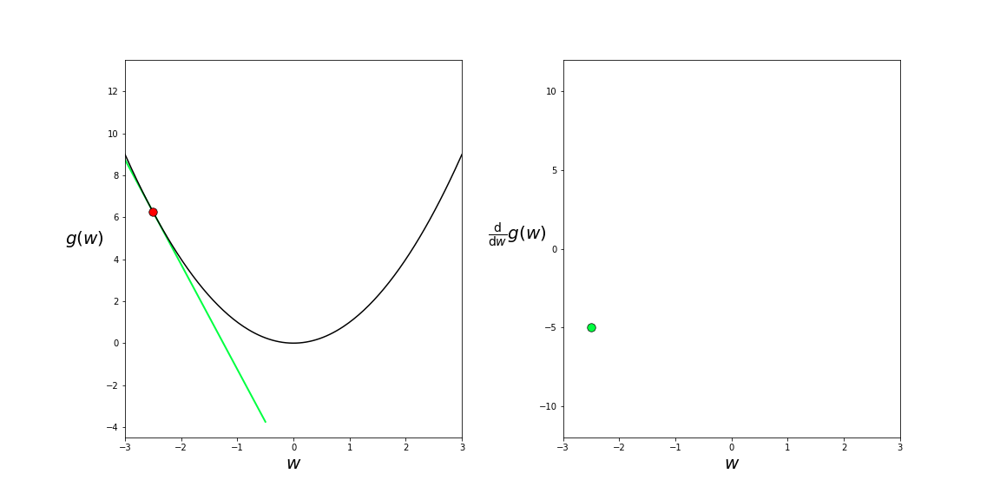
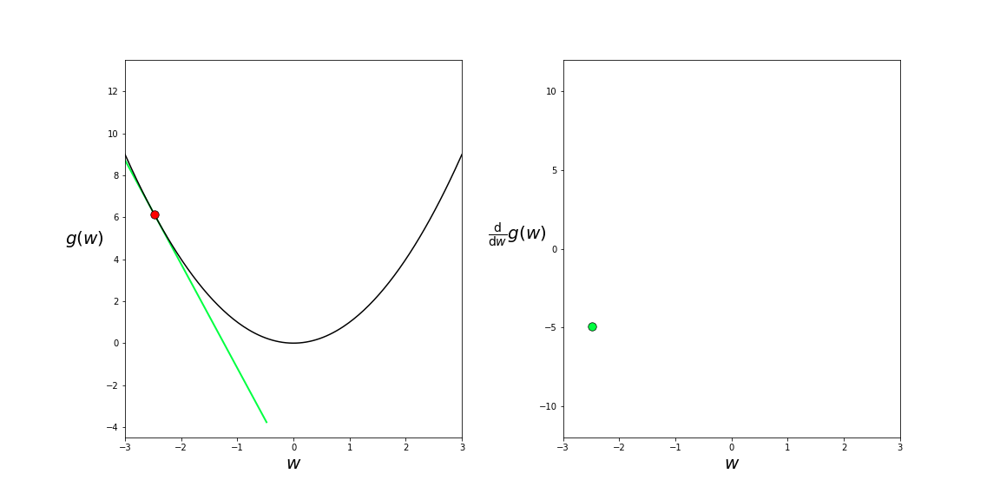
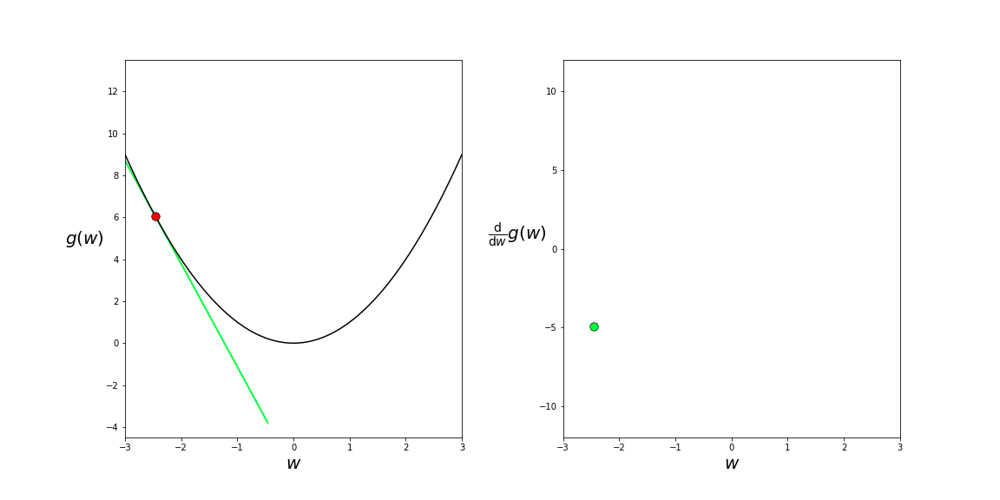
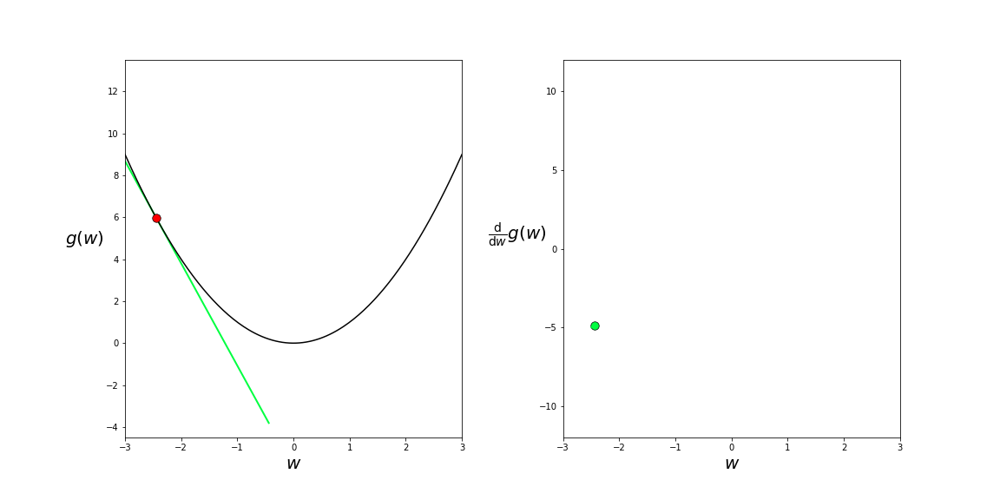
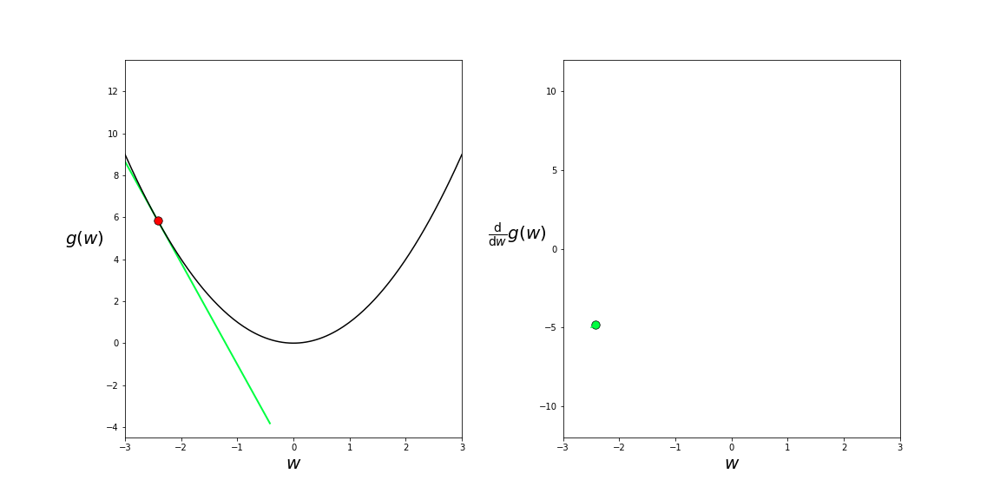
...
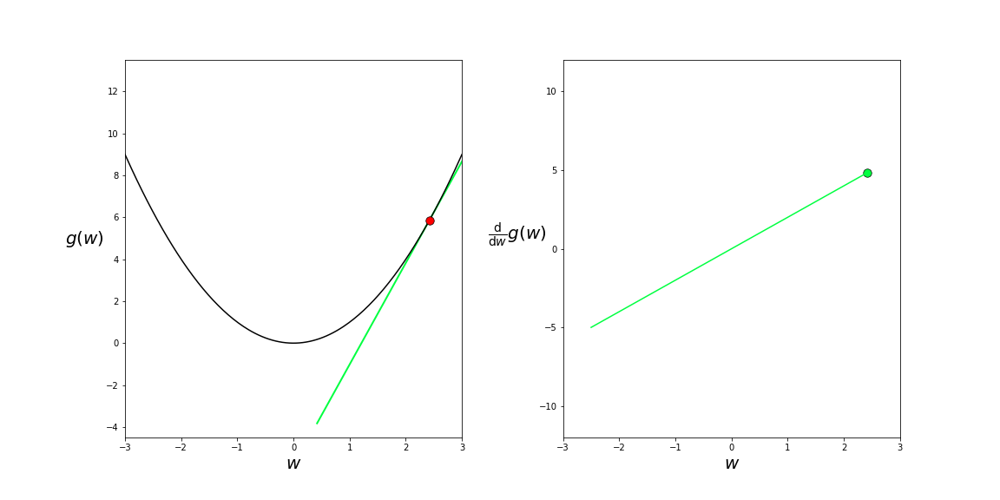
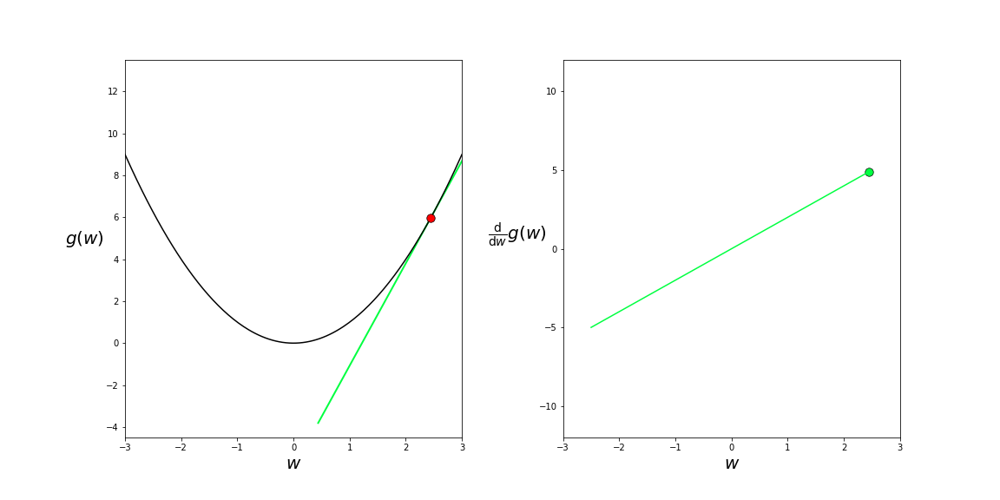
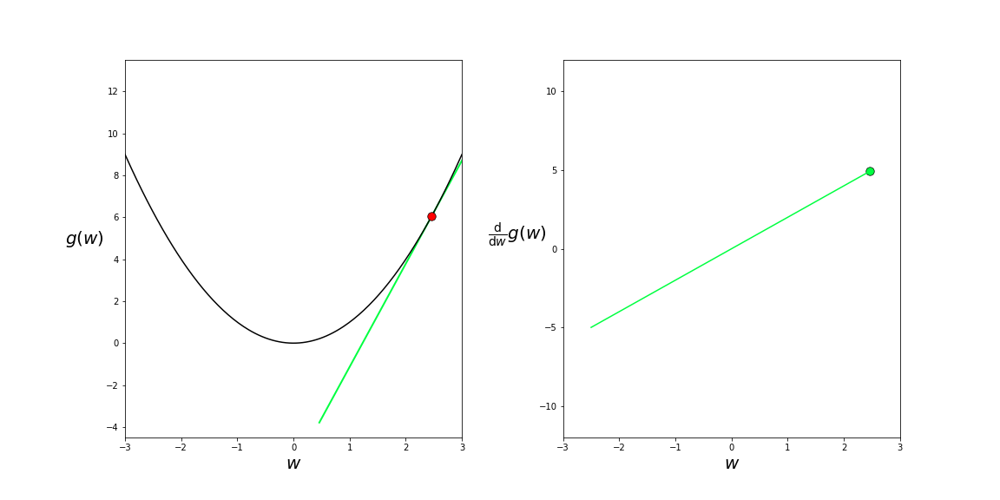
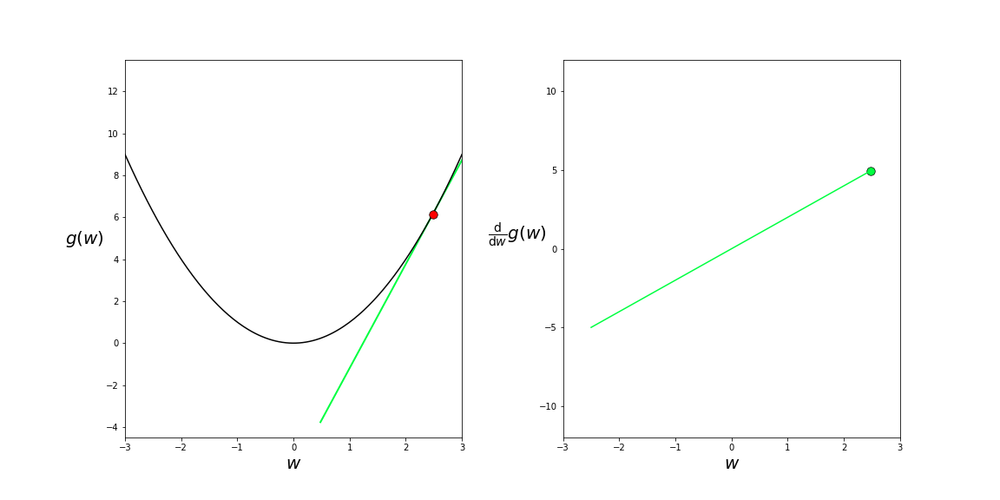
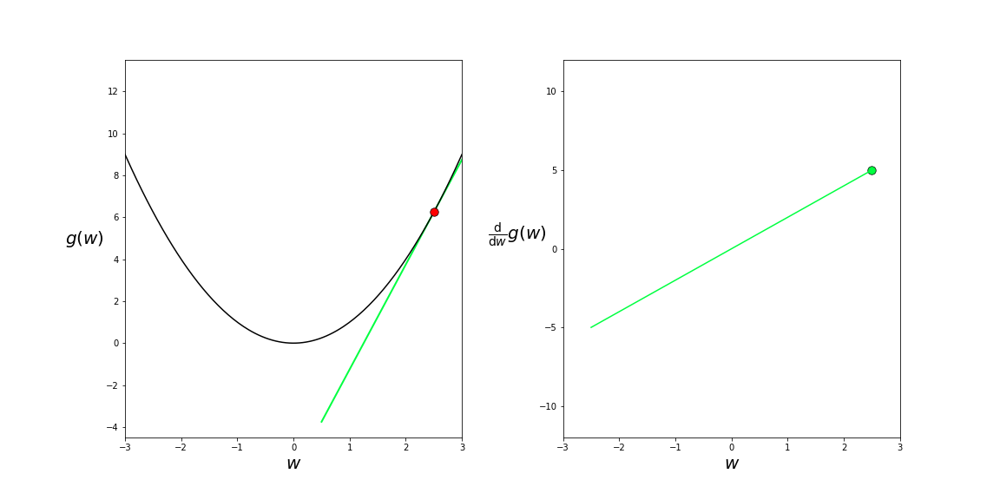

In [2]:
# what function should we play with?  Defined in the next line, along with our fixed point where we show tangency.
g = lambda w: w**2

# create an instance of the visualizer with this function
st = calclib.function_derivative_joint_visualizer.visualizer(g = g)

# run the visualizer for our chosen input function and initial point
st.draw_it(num_frames = 250)

Here the plotted derivative looks like a line!  In fact - pushing the slider all the way to the right - from the picture it looks like we can be more specific: the line cross the origin, so the vertical intercept must be zero, and at $w = 2.5$ (the end of the plot) the output value looks to be around $g(2.5) = 5$, so the slope of this line appears to be around $\frac{g(2.5) - g(0)}{2.5 - 0} = \frac{5}{2.5} = 2$.  So - at least over the region of input plotted - the equation of the derivative appears to be 

$$ \frac{\mathrm{d}}{\mathrm{d}w}g(w) = 2w$$

#### <span style="color:#a50e3e;">Example. </span> Plotting the derivative of $g(w) = \text{sin}(3w)$

Lets try the same experiment with another function - the sinusoid

\begin{equation}
g(w) = \text{sin}(3w)
\end{equation}


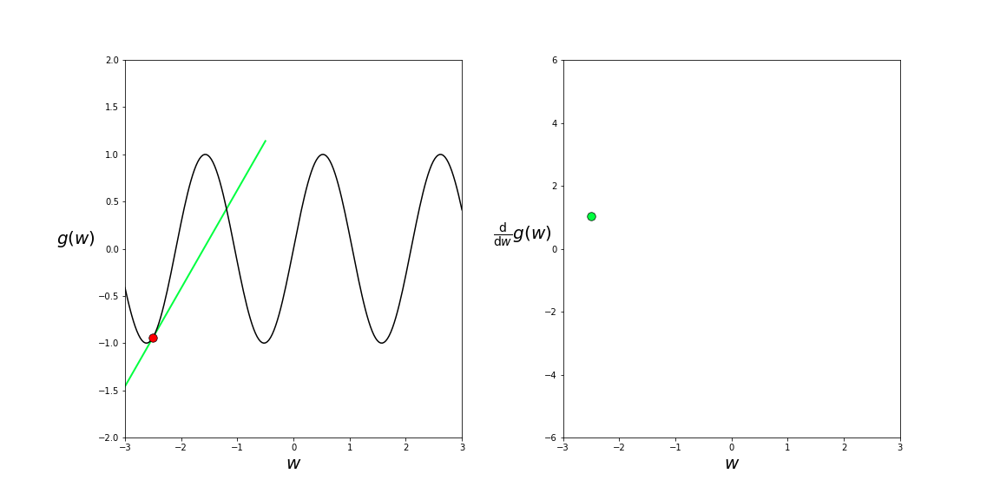
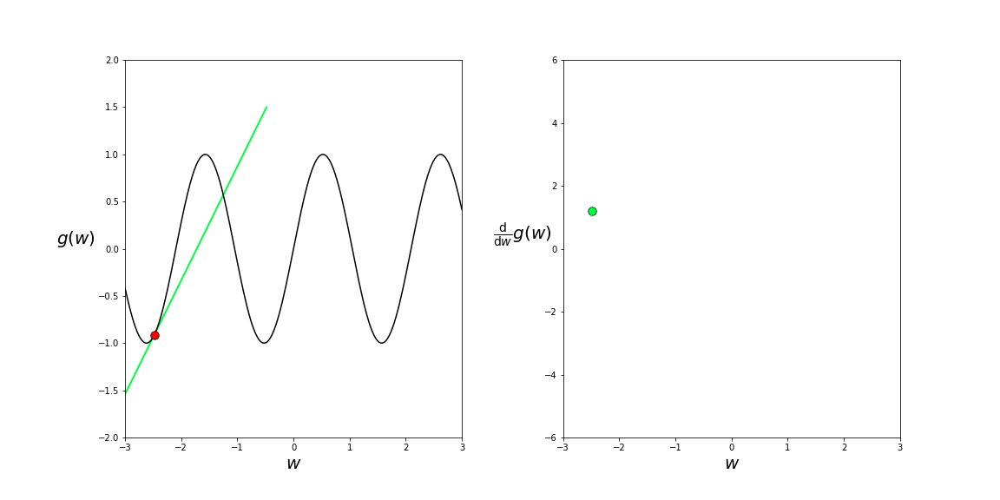
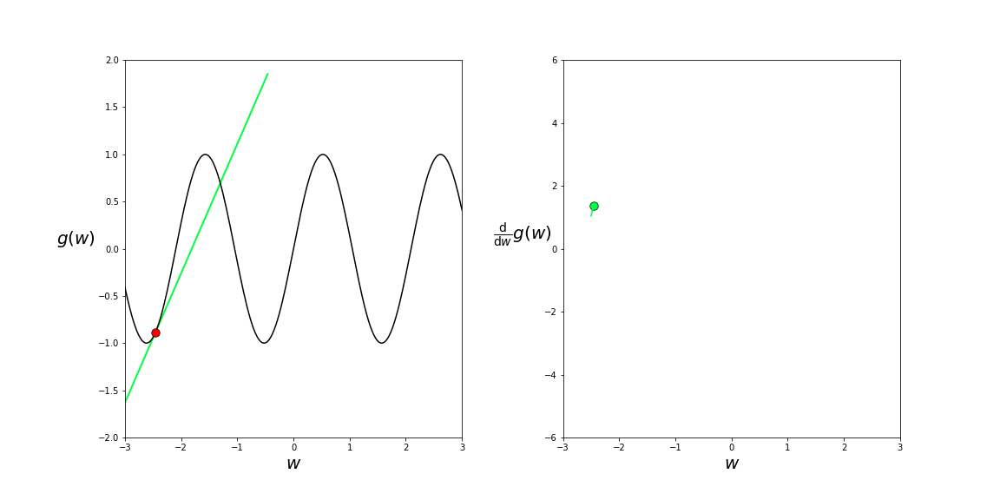
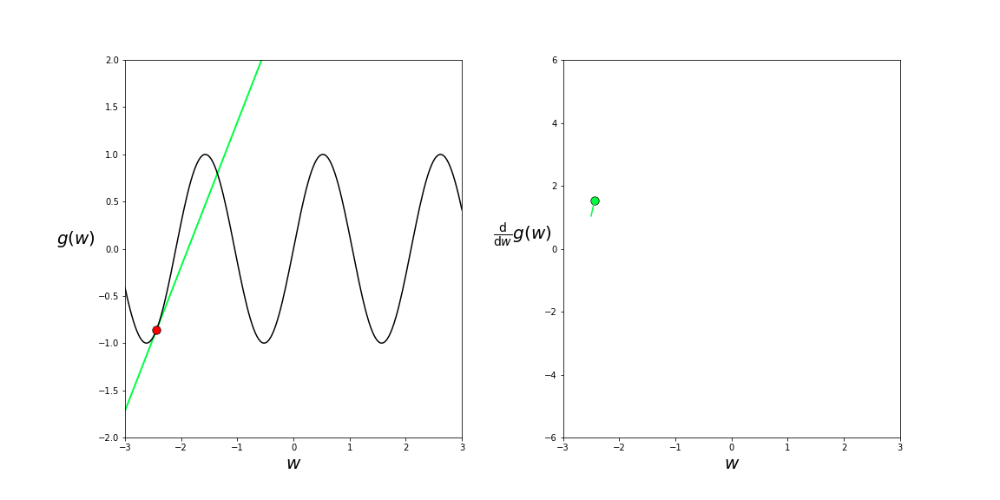
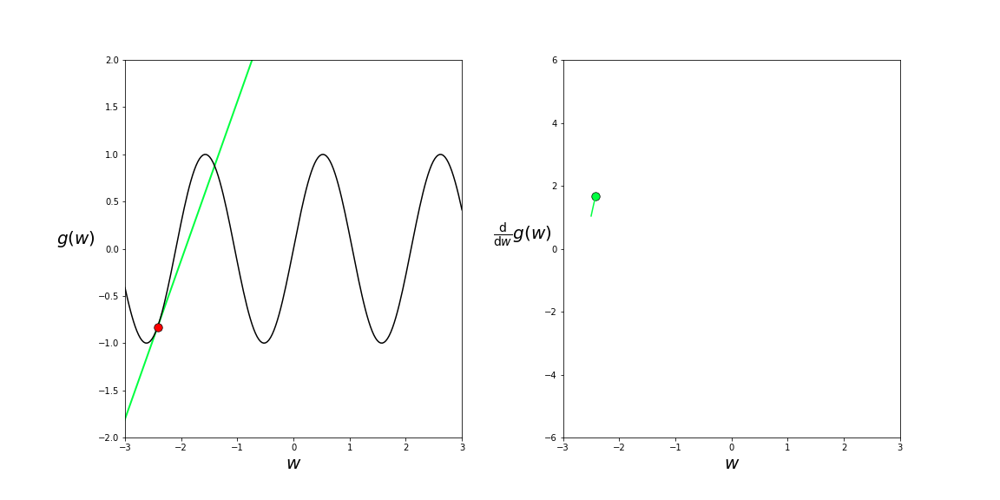
...
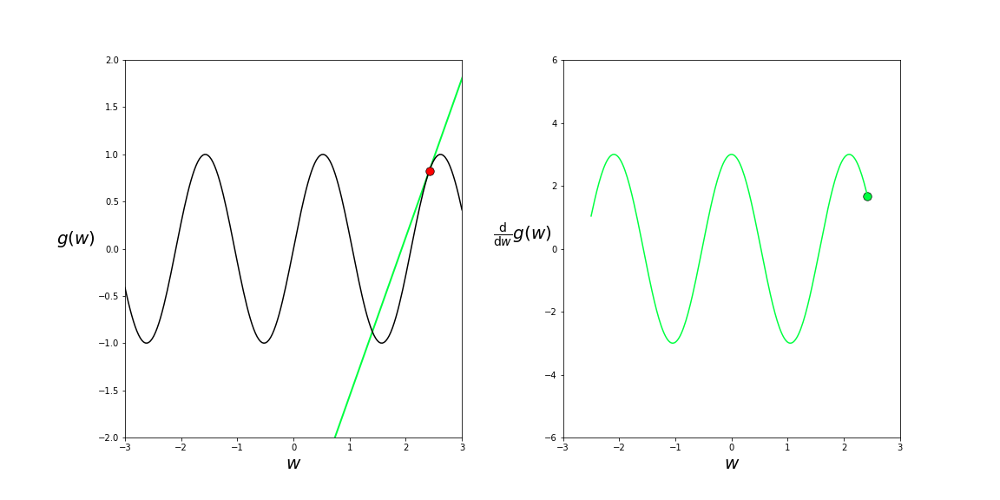
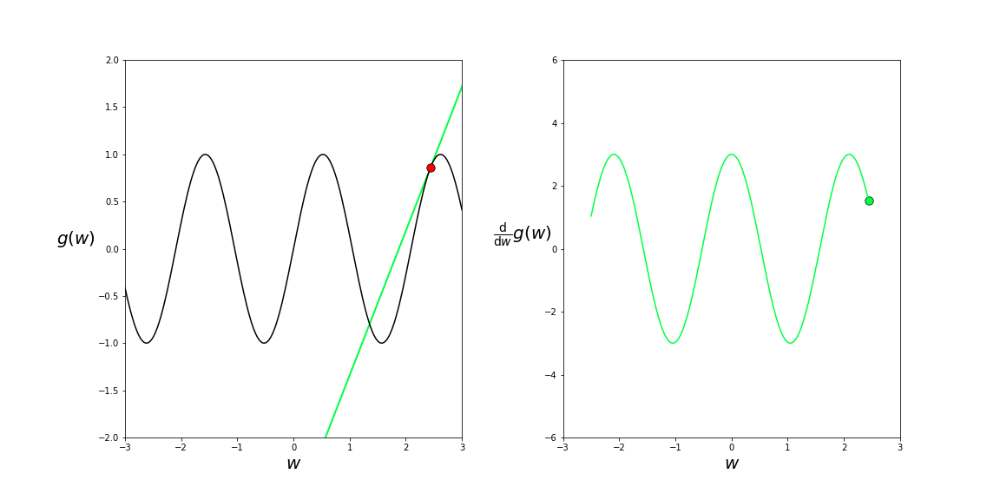
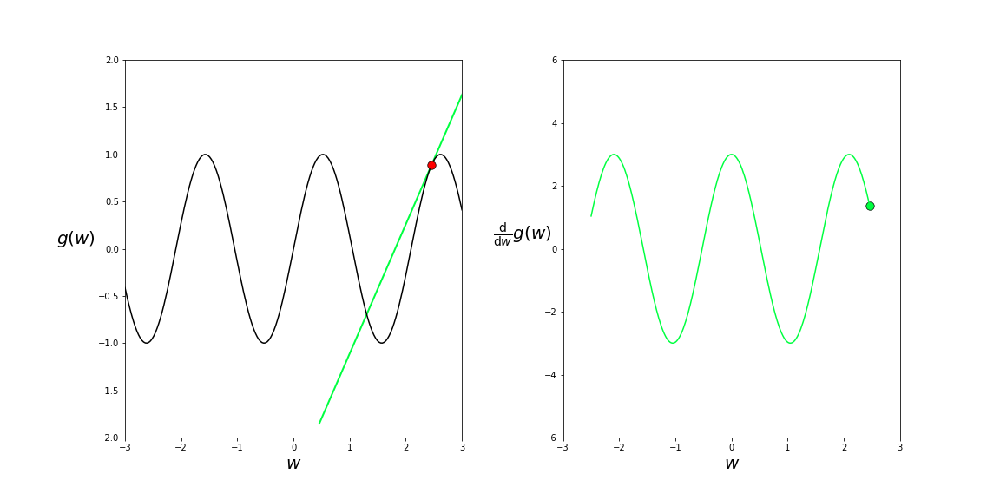
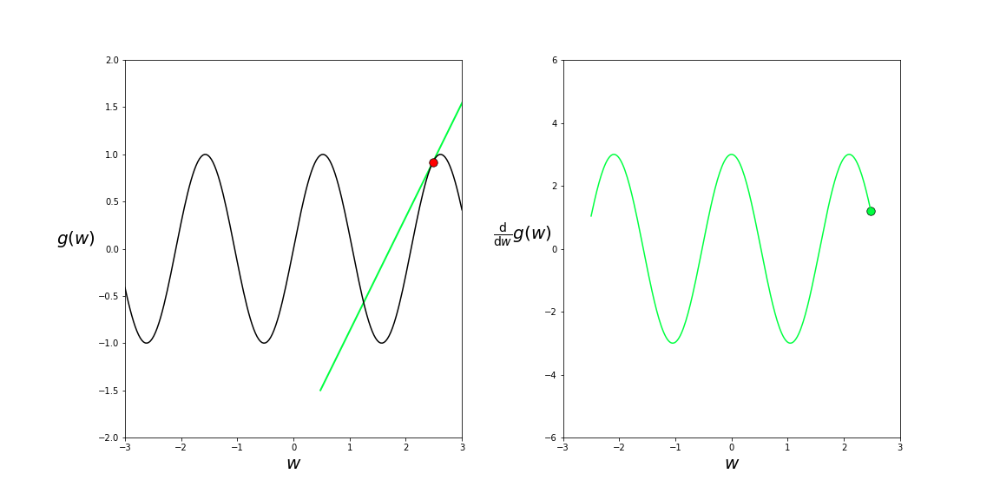
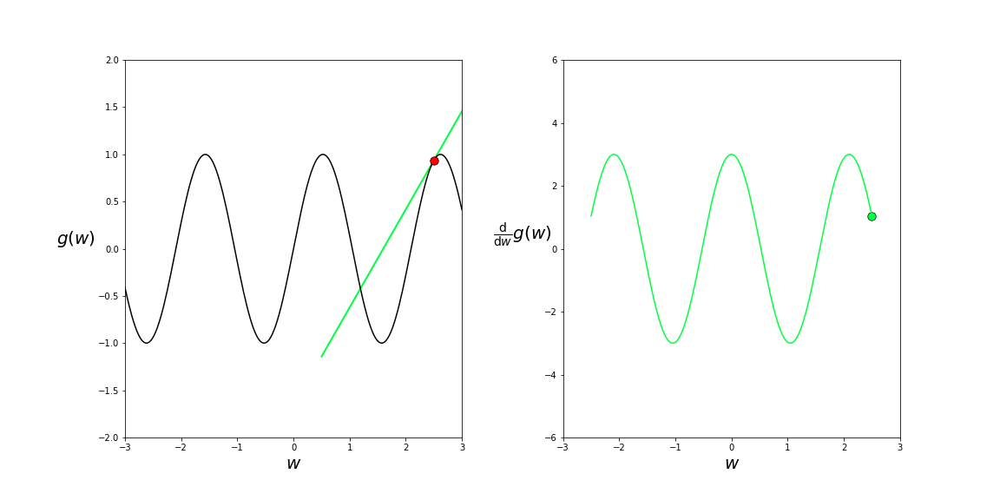

In [3]:
# what function should we play with?  Defined in the next line, along with our fixed point where we show tangency.
g = lambda w: np.sin(3*w)

# create an instance of the visualizer with this function
st = calclib.function_derivative_joint_visualizer.visualizer(g = g)

# run the visualizer for our chosen input function and initial point
st.draw_it(num_frames = 250)

All right - push the slider all the way to the right and lets examine the derivative.  Well first off one thing we can say is that the derivative looks pretty wavy - like a sine or cosine function, and of the same frequency as the original function itself.  Since its value at $w = 0$ is maximal we could say that some sort of cosine equation might work.  Notice too that the *magnitude* of the derivative - its vertical range -  is larger than that of the original function.  In fact it stretches from around -3 to 3.  Putting together these pieces we could loosely guess that an equation for the derivative over this range of input looks something like

$$ \frac{\mathrm{d}}{\mathrm{d}w}g(w) = 3\text{cos}(3w) $$

Guessing this by eye-balling a plot of the original function's derivative was certainly harder to come up with than when we did this with the previous example of $g(w) = w^2$.

#### <span style="color:#a50e3e;">Example. </span> Plotting the derivative of $g(w) = e^{3w}\frac{\text{sin}(\pi^2w)}{\pi^2w}$

Ok - one more.  Lets try the experiment with a crazier looking function

\begin{equation}
g(w) = e^{3w}\frac{\text{sin}(\pi^2w)}{\pi^2w}
\end{equation}


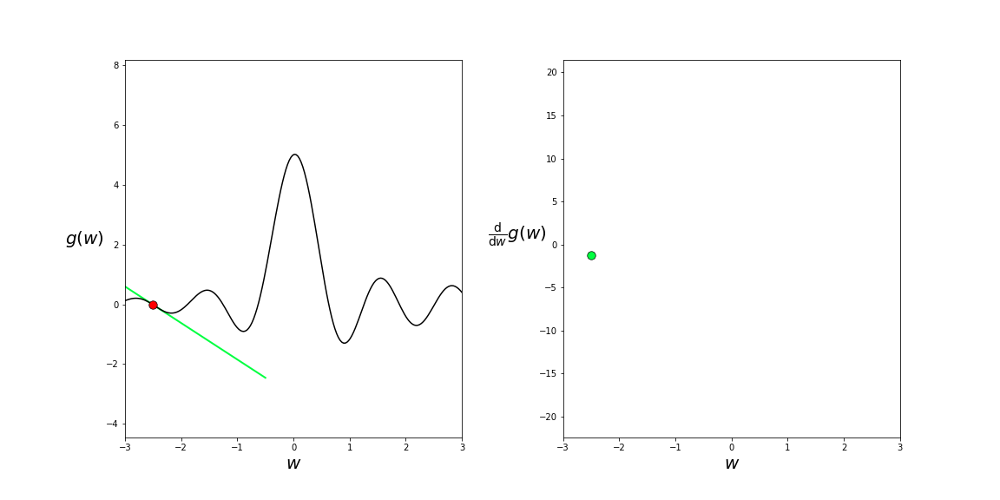
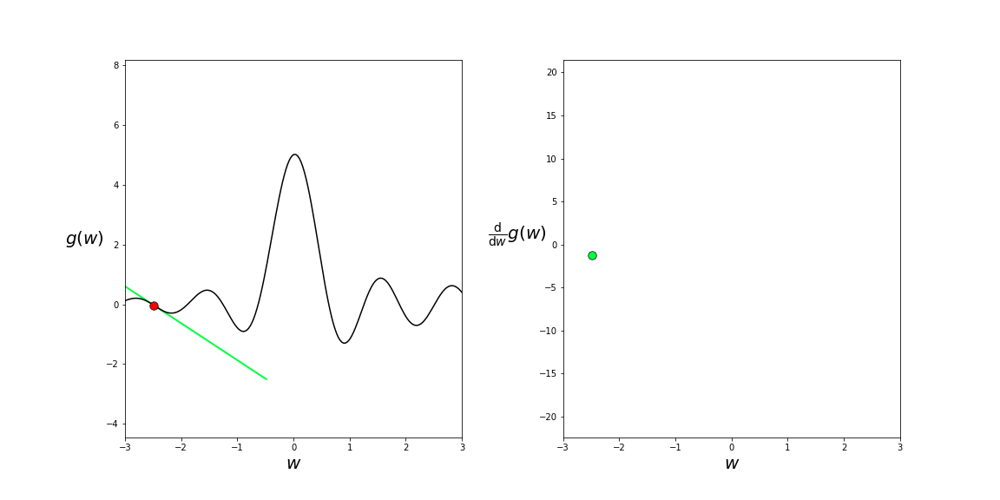
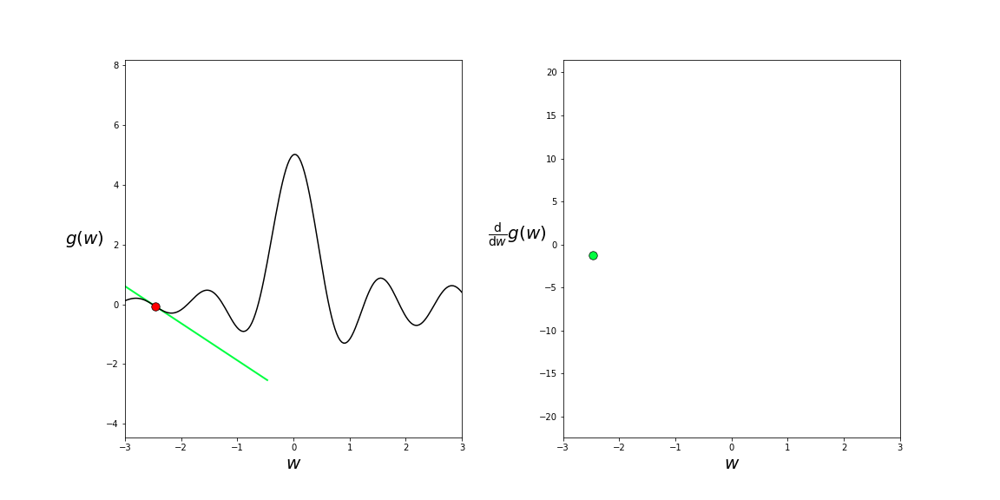
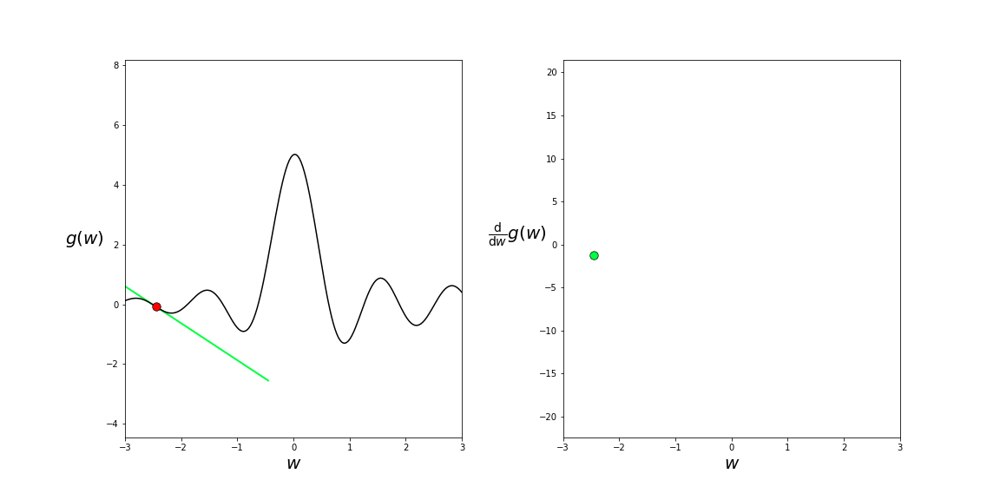
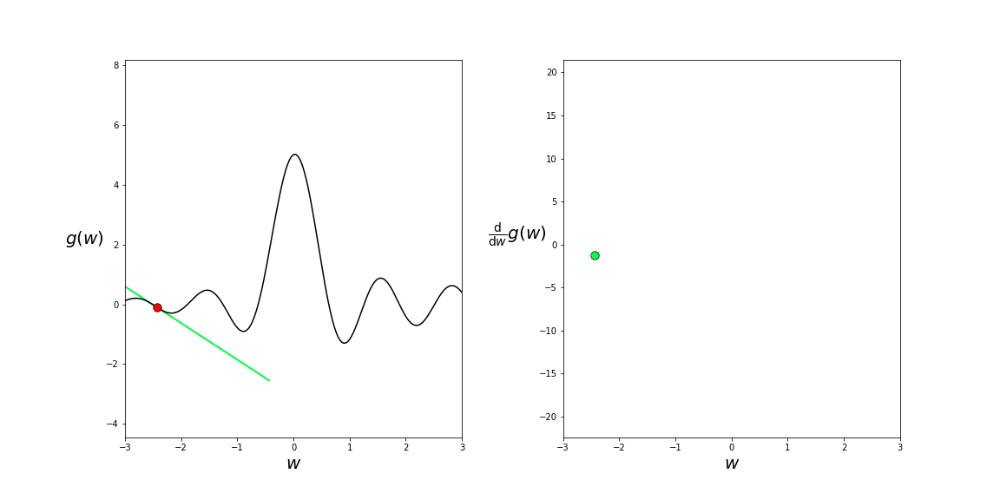
...
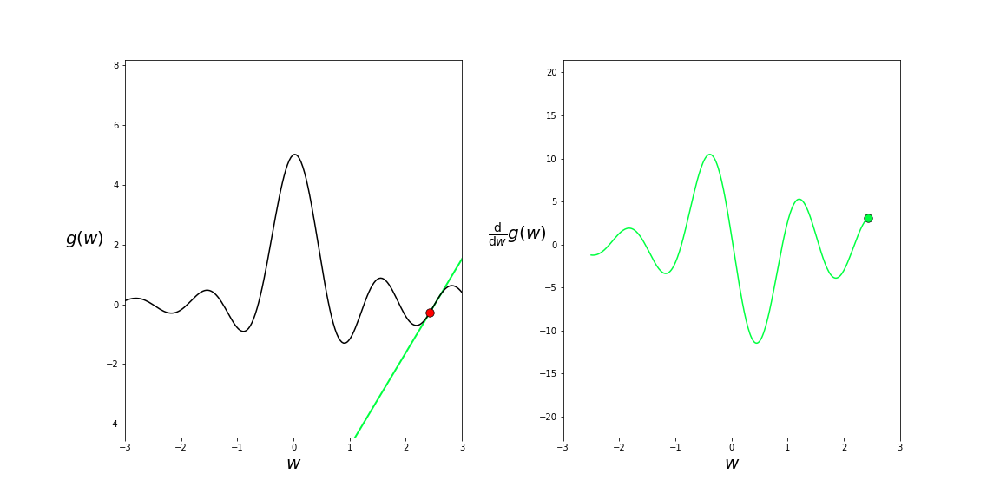
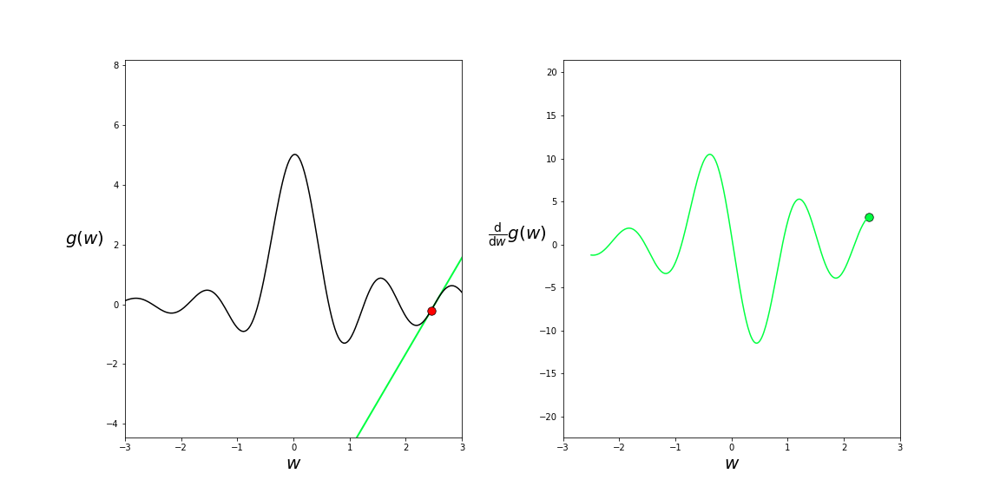
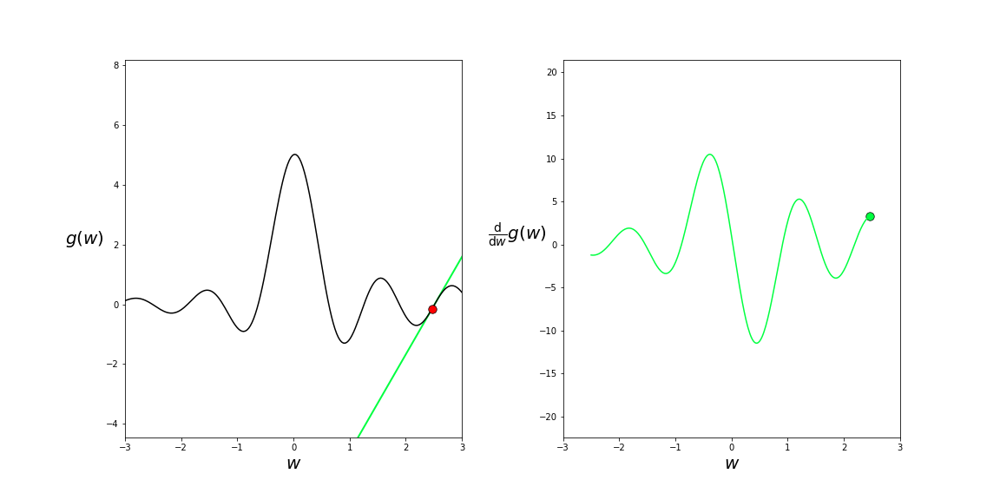
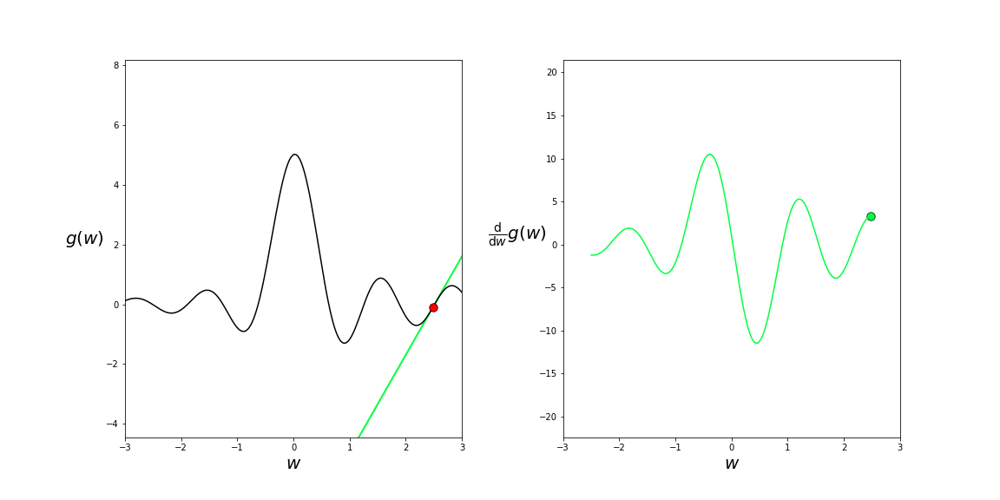
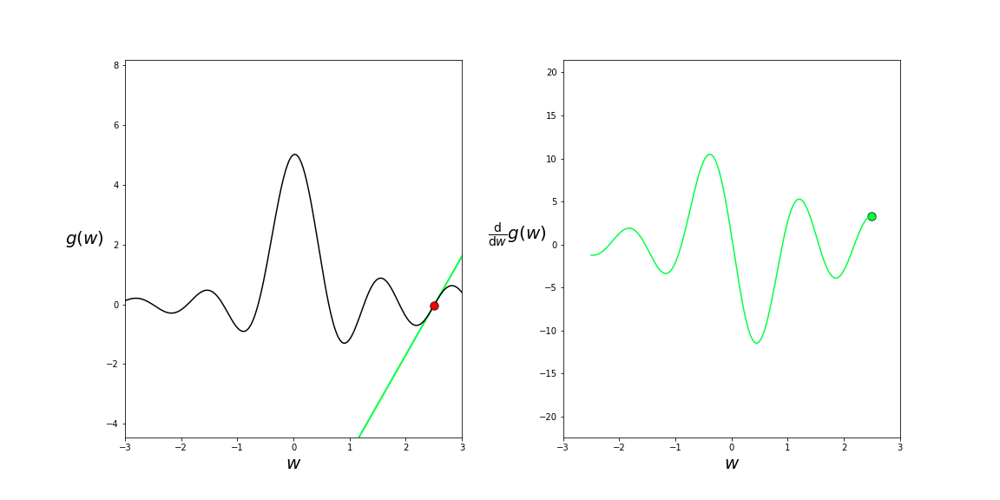

In [4]:
# what function should we play with?  Defined in the next line, along with our fixed point where we show tangency.
g = lambda w: np.exp(0.2*w)*np.sin(5*w)/w

# create an instance of the visualizer with this function
st = calclib.function_derivative_joint_visualizer.visualizer(g = g)

# run the visualizer for our chosen input function and initial point
st.draw_it(num_frames = 300)

All right - push the slider all the way to the right.  What sort of equation can we conjure up that might represent the derivative in this case?  Its much harder to tell with this example - does one even exist? This example is indicative of just how challenging it can be in general to try to glean the equation of a derivative by eye-balling a plot of its table of values.

### Wrapping up

While the equation of the derivative was not at all easy to eyeball by plotting in the final example, we need not let this example crush the hope that - in general - an equation might exist for the derivative of a general function, as in the first two cases a reasonable equation was indeed derived by examining the derivative plot.  For many cases - certainly for machine learning applications - derivatives in fact do have equations associated with them.  In order to come up with a consistent and wide ranging rule for finding them - however - we need to go beyond visual examination and use a bit of mathematics.

## 1.2  Derivative equations can be calculated for virtually any formula one can imagine

Our experiments above seem to imply that we may be able to write down an equation for the derivative of at least some elementary functions.  **In fact we can find equations for every elementary function, and virtually every combination of elementary functions.**   This is a profound fact - every elementary function with known equations including lines, polynomials, trigonometric functions (sine, cosine, tanh, etc.,), transcendental functions (log, exponentials, etc.,), and even functions that are not differentiable everywhere (e.g., the relu function) have closed form formulae for their derivatives, as well as virtually every combination of these functions one can imagine.

In Table 1 below we show *derivative formulae for popular elementary functions*, and for completion provide derivations for many of them in an appendix Section that follows this one.  The calculations leading to these derivative formulae are not overly important in and of themselves for our context, but the formulae themselves (of which many more can be found in any standard calculus resource) are absolutely invaluable in machine learning / deep learning (as they are in many branches of science) and arise almost everywhere due to the all-encompassing presence of mathematical optimization.

<br>
<table>
  <col width="100">
  <col width="100">
<thead>
<tr>
    <th>elementary function</th>
    <th>derivative formula</th> 
  </tr>
  </thead>
  <tbody>
    <tr>
    <td>$c$ (any constant)</td>
    <td>$0$</td>
  </tr>
  <tr>
    <td>$w^p$</td>
    <td>$pw^{p-1}$</td>
  </tr>
    <tr>
    <td>$\text{sin}(w)$</td>
    <td>$\text{cos}(w)$</td>
  </tr>
  <tr>
    <td>$\text{cos}(w)$</td>
    <td>$-\text{sin}(w)$</td>
  </tr>
  <tr>
    <td>$e^w$</td>
    <td>$e^w$</td>
  </tr>
  <tr>
    <td>$\text{log}(w)$</td>
    <td>$\frac{1}{w}$</td>
  </tr>
    <tr>
    <td>$\text{tanh}(w)$</td>
    <td>$1 - \text{tanh}^2(w)$</td>
  </tr>
    <tr>
    <td>$\text{max}(0,w)$</td>
    <td>$\begin{cases}
0 & w\leq0\\
1 & w>0
\end{cases}$</td>
  </tr>
  </tbody>
</table>

As if this was not phenomenonal enough, the same [simple definition of the derivative]() leads to the fact that the derivative of every sort of simple combination of two functions - which consist of just a few possible operations (addition, multiplication, composition) - can be expressed in terms of the derivative formula of each individual function in combination.  When used repeatedly, these *arithmetic rules of the derivative* allow one to find the formula of essentially any function one can write down on paper.  For convenience we list these operations in Table 2 below - written down for general functions $f(w)$ and $g(w)$ - and again provide derivations for their veracity in the Appendix section following this one. 

<br>
<table>
  <col width="500">
  <col width="100">
  <col width="400">
<thead>
<tr>
    <th>combination type</th> 
    <th>functional form</th>
    <th>derivative rule</th> 
  </tr>
  </thead>
  <tbody>
    <tr>
    <td> multiplication by a constant $c$ </td>
    <td> $cg$</td>
    <td>$\frac{\mathrm{d}}{\mathrm{d}w}\left(cg(w)\right)=  c\frac{\mathrm{d}}{\mathrm{d}w}g(w)$</td>
  </tr> 
  <tr>
  <td> addition of functions (often called the *summation rule*)</td>
    <td> $f + g$ </td>
    <td>$\frac{\mathrm{d}}{\mathrm{d}w}(f(w) + g(w))=  \frac{\mathrm{d}}{\mathrm{d}w}f(w) + \frac{\mathrm{d}}{\mathrm{d}w}g(w)$</td>
  </tr> 
  <tr>
  <td> multiplication of functions (often called the *product rule*) </td>
    <td> $f\cdot g$ </td>
    <td>$\frac{\mathrm{d}}{\mathrm{d}w}(f(w)\cdot g(w))=  \left(\frac{\mathrm{d}}{\mathrm{d}w}f(w)\right)\cdot g(w) + f(w)\cdot \left(\frac{\mathrm{d}}{\mathrm{d}w}g(w)\right)$
    </td>
  </tr>
  
  <tr>
  <td> division of functions (often called the *quotient rule*) </td>
    <td> $\frac{f}{g}$ </td>
    <td>$\frac{\mathrm{d}}{\mathrm{d}w}\left(\frac{f(w)}{g(w)}\right) =  \frac{\frac{\mathrm{d}}{\mathrm{d}w}f(w)\cdot g(w) - f(w)\cdot \frac{\mathrm{d}}{\mathrm{d}w}g(w)}{(g(w))^2}$
    </td>
  </tr>
  
  
  <tr>
  <td> composition of functions (often called the *chain rule*)</td>
    <td> $f(g(w))$ </td>
    <td>$\frac{\mathrm{d}}{\mathrm{d}w}(f(g(w)))= \frac{\mathrm{d}}{\mathrm{d}g}f(g) \cdot \frac{\mathrm{d}}{\mathrm{d}w}g(w)$
  </td>
  </tr>
  </tbody>
</table>

Note again how the arithmetic rules in Table 2 are for *generic functions*.  There are not two distinct rules telling one how to calculate the derivative formula for the sum of two polynomials, and the sum of two sinusoidal functions: there is just one rule for addition.  Likewise, there are not two rules telling one how to derive formula for the product of an exponential and a polynomial, and an sinusoid and a logarithm: there is only one rule for taking the derivative of a product of functions.  

> Every elementary function with known equations including lines, polynomials, trigonometric functions (sine, cosine, tanh, etc.,), transcendental functions (log, exponentials, etc.,), and even functions that are not differentiable everywhere (e.g., the relu function) have closed form formulae for their derivatives, as well as virtually every combination of these functions one can imagine.  

By using a handful of simple rules that tell us how to deal with the combination of two or more elementary functions, along with perhaps a dozen specific elementary function derivative formulae like the ones shown in Table 1, one can write down a formula for the derivative of virtually any function one can dream up.  And because of this any function built out of elementary functions and operations has a derivative formulae that too is constructed from elementary parts.

> Any function built out of elementary functions and operations has a derivative formulae that too is constructed from elementary parts.

Moreover, because any such function can be broken down into a sequence of [basic operations on one or two elementary functions](basics of functions part 2) if we are patient and break down a given function into its sequence *we only ever need apply the derivative rules in Table 2 to elementary functions*.  

> Computing the derivative of a generic function that is constructed from elementary functions and operations reduces to computing the derivatives of these elementary functions using the specific derivative formulae in Table 1, while only needing to apply the deritvative operations in Table 2 to these elementary functions.

This piece is - practically speaking - extremely important: it says that the computation of a general function's derivative is in fact equivalent to computing the derivatives of the elementary functions that it is built out from, and combining them according to the operations listed in Table 2.  We will see several examples of how this is done in the next Subsection.  

## 1.4  Employ derivative rules for relatively simple examples 

Lets look at how we can apply the formulae and rules in Tables 1 and 2 above to computing derivative equations.  We apply them in an algorithmic way based on the following two steps
 
1.  Decompose the general function into its elementary functions and operations, as first discussed in [our basic function series]().
2.  Apply the formulae / rules from Table 1 and 2 sequentially
3.  Combine the resulting calculations to form a derivative formula for the original function

#### <span style="color:#a50e3e;">Example. </span> Derivative of $g(w) = \text{sin}(w^3)$

Lets first decompose this function into its parent-child equations (as first described in our [post on computation graphs]()).  We write these as

\begin{array}
\
a(w) = w^3 \\
b(a) = \text{sin}(a)\\
\end{array}

where  $g(w) = b(a(w))$.  Here we have that $a$ is the child of the parent $b$ - thus $b$ treats $a$ as an input variable.  We plot the simple computation graph represented by these parent-child equations below.

<p><img src="../../mlrefined_images/calculus_images/computation_graph_1.png" width="45%" height="auto"></p>

Then we can break apart computing the derivative $\frac{\mathrm{d}}{\mathrm{d}w}g(w) = \frac{\mathrm{d}}{\mathrm{d}w}b(a(w))$ into simple stages.  Because the parent-child equation are nested compositions we must employ the chain rule from Table 2 with each 

$$
\frac{\mathrm{d}}{\mathrm{d}w}b(a(w)) = \frac{\mathrm{d}}{\mathrm{d}a}b(a)\frac{\mathrm{d}}{\mathrm{d}w}a(w)\frac{\mathrm{d}}{\mathrm{d}w}w
$$

Each derivative on the right hand side above is a derivative of an elementary function by definition - and we can find the equation for each in the formulae of Table 1.  In particular we have

\begin{array}
\
\frac{\mathrm{d}}{\mathrm{d}a}b(a) = \frac{\mathrm{d}}{\mathrm{d}a}\text{sin}(a) = \text{cos}(a) \\
\frac{\mathrm{d}}{\mathrm{d}w}a(w) = \frac{\mathrm{d}}{\mathrm{d}w}w^3 = 3w^2 \\
\frac{\mathrm{d}}{\mathrm{d}w}w = 1
\end{array}

Note that since $\frac{\mathrm{d}}{\mathrm{d}w}w = 1$ it is redundant, and can be removed.  Since $a = w^3$ by definition we have all together using these two derivatives of elementary functions that 

$$
\frac{\mathrm{d}}{\mathrm{d}w}b(a(w)) = \frac{\mathrm{d}}{\mathrm{d}a}b(a)\frac{\mathrm{d}}{\mathrm{d}w}a(w)= \text{cos}(a)\times3w^2 = \text{cos}(w^3)\times3w^2
$$

Lets take a minute to appreciate what we have here.  We started off wanting to compute the derivative of $g(w) = \text{sin}(w^3)$ - which is **not** an elementary function with a known formula in Table 1.  But the computation graph / parent-child decomposition of this function allows us to express derivative 100% completely in terms of the derivatives of elementary functions, whose forms **are known** and shown in Table 1.  And - as we will see through examination of further examples as well - is completely general.

> The computation graph / parent-child equation deconstruction of a function - in breaking up the function into a nested composition of simple functions / operations - allow us to express (via the chain rule) the derivatives of complex functions in terms of the derivatives of elementary functions.

#### <span style="color:#a50e3e;">Example. </span> Computing the derivative of $g(w) = \text{tanh}(w)\text{cos}(w) + \text{log}(w)$ going backwards through the computation graph

We first represent the parent-child relationships in this function by drawing its computation graph.

<p><img src="../../mlrefined_images/calculus_images/computation_graph_2.png" width="65%" height="auto"></p>

In order to write out the full expression for the derivative here we must recursively apply the chain rule to each parent node in the graph.  We begin by applying the chain rule to the last parent node $e$ relative to its children $c$ and $d$, and work backwards through the graph.

$$
\frac{\mathrm{d}}{\mathrm{d}w}e(c,d) =  \frac{\mathrm{d}}{\mathrm{d}c}e(c,d)\frac{\mathrm{d}}{\mathrm{d}w}c(w) + \frac{\mathrm{d}}{\mathrm{d}d}e(c,d)\frac{\mathrm{d}}{\mathrm{d}w}d(a,b) 
$$

Note that because we know the form of $e$ we can immediately compute the derivatives of $e$ with respect to its children - i.e., $\frac{\mathrm{d}}{\mathrm{d}d}e(c,d) = 1$ and $\frac{\mathrm{d}}{\mathrm{d}c}e(c,d) = 1$.  What about the derivatives of each child with respect to $w$?  We have to apply the chain rule again on each.  For the derivative on $c$ we can can compute

$$
\frac{\mathrm{d}}{\mathrm{d}w}c(w) = \frac{1}{w}
$$

and for $d$

$$
\frac{\mathrm{d}}{\mathrm{d}w}d(a,b) = \left(\frac{\mathrm{d}}{\mathrm{d}w}a(w)\right)\times b(w)  + a(w) \times \left(\frac{\mathrm{d}}{\mathrm{d}w}b(w)\right)
$$

which necessitated using the use of the *product rule* given that $d(a,b) = a \times b$.  And since both $a$ and $b$ are elementary functions whose derivatives are in Table 1, we can quickly compute this derivative

$$
\frac{\mathrm{d}}{\mathrm{d}w}d(a,b) = (1 - \text{tanh}^2(w))\times \text{cos}(w)  + \text{tanh}(w) \times (-\text{sin}(w))
$$

Note here when computing $\frac{\mathrm{d}}{\mathrm{d}w}a(w) = \frac{\mathrm{d}}{\mathrm{d}w}\text{tanh}(w)\frac{\mathrm{d}}{\mathrm{d}w}w$ according to the chain rule, but we can ignore $\frac{\mathrm{d}}{\mathrm{d}w}w = 1$ since it is of no significance.  Likewise for $b$, and we will follow this convention from now on.

With all derivatives of parent nodes accounted for we can put all of our calculations together - giving the desired derivative

$$
\frac{\mathrm{d}}{\mathrm{d}w}g(w) = \frac{\mathrm{d}}{\mathrm{d}w}e(c,d) =   (1 - \text{tanh}^2(w))\times \text{cos}(w) +   \text{tanh}(w) \times (-\text{sin}(w)) + \frac{1}{w}
$$

---
Note the overall the recursive pattern of derivative taking we have seen here, where we repeated these two steps over and over again until there are no more proper derivatives to take.   This pattern holds in general as well.


1. All derivatives of a parent with respect to its children are derivatives of elementary functions, and are computed in closed form using Table 1.
2.  When it comes to taking the derivative of a child with respect to $w$ we treat the child as a parent node, to which we must apply the chain rule.

#### <span style="color:#a50e3e;">Example. </span> Computing the derivative of $g(w) = \text{tanh}(w)\text{cos}(w) + \text{log}(w)$ going forwards through the computation graph

In the previous example we computed the derivative of this function starting at the end parent node $e$ and traveling backwards through the graph to $w$.  In this example we look at how to compute starting at node $w$ and moving fowards to the graph ending at $e$.

Starting at $w$ we see it has three parents: $a$, $b$, and $c$.  Computing each parent-child derivative we have
    
\begin{array}
\
\frac{\mathrm{d}}{\mathrm{d}w}a(w) = (1 - \text{tanh}^2(w)) \\
\frac{\mathrm{d}}{\mathrm{d}w}b(w) =  -\text{sin}(w)\\
\frac{\mathrm{d}}{\mathrm{d}w}c(w) = \frac{1}{w} \\
\end{array}

With these derivatives witih respect to $w$ computed we move upwards to the next parents in the graph, seeking to derive derivatives of these nodes with respect to $w$ as well.  Examining the graph we can see that the parent of $a$ and $b$ is $d$, and the parent of $c$ is $e$.    

Lets start with $d$.  We next want to compute $\frac{\mathrm{d}}{\mathrm{d}w}d(a,b)$.   Because $d$ is a product of $a$ and $b$ we must use the product rule, and this derivative is given as

$$
\frac{\mathrm{d}}{\mathrm{d}w}d(a,b) = \left(\frac{\mathrm{d}}{\mathrm{d}w}a(w)\right)\times b(w)  + a(w) \times \left(\frac{\mathrm{d}}{\mathrm{d}w}b(w)\right)
$$

Now because we are moving forward through the graph we have already computed the derivatives of $a$ and $b$ with respect to $w$, and need only compute the parent-child derivatives which are easily given as

\begin{array}
\
\frac{\mathrm{d}}{\mathrm{d}a}d(a,b) = b = \text{cos}(w)\\
\frac{\mathrm{d}}{\mathrm{d}b}d(a,b) = a = \text{tanh}(w) \\
\end{array}

Thus the entire derivative can be computed explicitly at this point as 

$$
\frac{\mathrm{d}}{\mathrm{d}w}d(a,b) = (1 - \text{tanh}^2(w))\times \text{cos}(w)  + \text{tanh}(w) \times (-\text{sin}(w))
$$

Now that we have resolved the derivative at $d$ we can work on the final parent node $e$, which is a parent of both $d$ and $c$.  Since $e$ is defined as the sum of $d$ and $c$ its derivative with respect to $w$ is written as 

$$
\frac{\mathrm{d}}{\mathrm{d}w}e(d,c) = \frac{\mathrm{d}}{\mathrm{d}w}d(a,b) + \frac{\mathrm{d}}{\mathrm{d}w}c(w)
$$

We have already computed both derivatives on the right side above, so plugging both in we have our desired derivative 

$$
\frac{\mathrm{d}}{\mathrm{d}w}g(w) = \frac{\mathrm{d}}{\mathrm{d}w}e(d,c) = (1 - \text{tanh}^2(w))\times \text{cos}(w)  + \text{tanh}(w) \times (-\text{sin}(w)) + \frac{1}{w}
$$

---

Lets summarize what we have just seen computing the derivative of this function going forward through the graph.

1. . 

#### <span style="color:#a50e3e;">Example. </span> Derivative of  $g(w) = e^{3w}\frac{\text{sin}(\pi^2w)}{\pi^2w}$

Lets first decompose this function into its parent-child equations, which gives (note here we will leave off the parentheses on the left side denoting input for readability purposes since the associated input of each equation is clear from the right hand side of each equation) 

\begin{array}
\
a = 20 \times x \\
b = x^2 \\
c = \text{cos}(a)\\
d = b + 1 \\
e = \frac{1}{d} \\
f = c\times e \\
\end{array}

We plot the computation graph below

<p><img src="../../mlrefined_images/calculus_images/computation_graph_3.png" width="65%" height="auto"></p>

and then we have $g(w) = f(c,e)$.  The derivative can then be written equivalently as 

$$
\frac{\mathrm{d}}{\mathrm{d}w}g(w) = \frac{\mathrm{d}}{\mathrm{d}w}f(c,e)
$$

Now - using the definition of $f$, as well as the product rule in Table 2, the derivative can be written equivalently as 

$$
\frac{\mathrm{d}}{\mathrm{d}w}f(c,e) = \left(\frac{\mathrm{d}}{\mathrm{d}w}e(d)\right) \cdot c(a,b) + e(d) \cdot \left(\frac{\mathrm{d}}{\mathrm{d}w}c(a,b)\right)
$$

In order to understand the derivatives on the right hand side we need to continue using rules from Table 2. Lets deal with them one at a time starting with the first term $\frac{\mathrm{d}}{\mathrm{d}w}e(d)$.  Using the chain rule, the definition of $d$ and $e$, and formulae for elementary functions in Table 1 we have

$$
\frac{\mathrm{d}}{\mathrm{d}w}e(d) = \frac{\mathrm{d}}{\mathrm{d}d}e(d) \cdot \frac{\mathrm{d}}{\mathrm{d}w}d(w) = e^{3w} \cdot 3
$$

Now - computing the derivative of the second term above in the derivative of $\frac{\mathrm{d}}{\mathrm{d}w}f(c,e)$ we have that - using the definition of $c(a,b)$ and the quotient rule we have

$$
\frac{\mathrm{d}}{\mathrm{d}w}c(a,b) = \frac{\frac{\mathrm{d}}{\mathrm{d}w}b(a) \cdot a(w) - b(a) \cdot \frac{\mathrm{d}}{\mathrm{d}w}a(w)}{(a(w))^2 }
$$

and using the definition of $b(a)$ and the chain rule to compute $\frac{\mathrm{d}}{\mathrm{d}w}b(a)$ we have

$$
\frac{\mathrm{d}}{\mathrm{d}w}b(a) = \frac{\mathrm{d}}{\mathrm{d}a}b(a) \cdot \frac{\mathrm{d}}{\mathrm{d}w}a(w) = \text{cos}(a) \pi^2 = \text{cos}(\pi^2w)\pi^2
$$

and so $\frac{\mathrm{d}}{\mathrm{d}w}c(a,b)$ can then be computed cmopletely using the definition $b$ and $a$

$$
 \frac{\mathrm{d}}{\mathrm{d}w}c(a,b) = \frac{\text{cos}(\pi^2w)\pi^2 \cdot \pi^2w - \text{cos}(\pi^2w) \cdot \pi^2 } {(\pi^2w)^2 }
$$

With both derivatives computed, we then have all together the derivative $\frac{\mathrm{d}}{\mathrm{d}w}g(w)$

$$
\frac{\mathrm{d}}{\mathrm{d}w}g(w)  = e^{3w} \cdot 3 \frac{\text{sin}(\pi^2w)}{\pi^2w} + e^{3w} \cdot \frac{\text{cos}(\pi^2w)\pi^2 \cdot \pi^2w - \text{cos}(\pi^2w) \cdot \pi^2 } {(\pi^2w)^2 }
$$

## 1.5  Section summary

We have now seen how - using a small set of universally applicable rules, and a diligent eye - we can compute the equation of a derivative for not only elementary functions, but virtually any combination of elementary functions one can imagine.  Leveraging those rules we computed several examples by hand, describing an effective algorithm involving a) decomposing a general function into its elementary functions and operations, and b) then applying the formulae / rules from Tables 1 and 2 to the individual components.  In the process we saw how computing the derivative of a general function required only the knowledge of how to compute the derivatives of elementary functions (some of which are shown in Table 1), and how to combine these equations using the operations listed in Table 2.  Furthermore, because of this, any function constructed out of elementary functions and operations has a derivative that must also be constructed from elementary functions/operations.

1.  We can find the derivative equation for virtually any function by first decomposing a it into elementary functions and operations, and then repeatedly applying the formulae / rules from Tables 1 and 2 to the individual components.  
2. Importantly these computations only require the knowledge of how to compute the derivatives of elementary functions (some of which are shown in Table 1), as well as how to combine these equations using the operations listed in Table 2.  
3.  Furthermore, because of this, any function constructed out of elementary functions and operations has a derivative that must also be constructed from elementary functions/operations.
4.  WHEN WE COMPUTE DERIVATIVES OF OUR DECONSTRUCTION, WE ALWAYS COMPUTE FROM TOP TO BOTTOM
5.  WAY DERIVATIVES FALL OUT, GUIDED BY DECONSTRUCTION, CHAIN RULE OMNIPRESENT, PARENT-CHILD STRUCTURE OF DECOMPOSITION GUIDES CHAIN RULE USAGE

However even though these computations are repeatable we soon saw how - practically speaking -  even moderately complicated formulae can produce large amounts of repeatable but messy computations [[1]](#endnotes).  While we will certainly see instances in the future where performing these hand calculations will be worth the work, where they will typically help to shed light on the behavior of an important function or optimization algorithm, in general we should hand over this work to a computer.

# 2.  Appendix of calculations

In this appendix we discuss how the simple definition of the derivative [discussed in the previous post]() can be used to derive formulae for elementary functions as well as the four simple combination rules mentioned in the previous Section that allow one to compute the derivative of an infinite variety of combinations of elemenatry functions.  Calculations which verify these formulae can found in virtually any calculus reference - we provide what we think are simpler and more transparent versions of such derivations for the interested reader.

## 2.1  Derivative formulae for derivatives of elementary functions

Remember this definition of the derivative at a point $w_0$ - [developed in the previous post in this series]() -  says that the slope of two secant lines - both of which share $w_0$ as one point and a point to either the left or right of $w_0$ as the other - should converge to the same value.  We ended by writing this compactly as 

\begin{equation}
 \frac{g(w_0 + \epsilon) - g(w_0)}{\epsilon} 
\end{equation}

which - if convergent for small magnitude $\epsilon$ - implies that $g$ has a derivative at $w_0$, which we wrote as $\frac{\mathrm{d}}{\mathrm{d}w}g(w_0)$.  Here we will be using this definition to show that certain elementary functions have derivatives at *every point* $w$, and that the derivative can be expressed by an equation.

In general the argument for showing that the derivative of a particular elementary function has a specific formula follow the same logic.  Here is the flavor of how such arguments are made.  First - compute the derivative using the definition above for a general point $w$ and small $\epsilon$ value, possibly applying a property or trick from algebra, trigonometry, or the study of transcendental formulae depending on the function.   Second: shrink the magnitude of $\epsilon$ to zero and out comes the general formula of the derivative.

#### <span style="color:#a50e3e;">Example. </span> Derivative of the constant function

Say our function $g(w) = c$ where $c$ is some constant (e.g., 1, -33.2, etc.,).  Let $\epsilon$ be some small magnitude number, then for a general point $w$

\begin{equation}
\frac{g(w + \epsilon) - g(w)}{\epsilon} = \frac{c - c}{\epsilon} = \frac{0}{\epsilon} = 0
\end{equation}

Neither the particular point $w$ nor the sign and magnitude of $\epsilon$ mattered above: the value is always equal to zero.  So here we have

\begin{equation}
\frac{\mathrm{d}}{\mathrm{d}w}g(w) = 0 
\end{equation}

#### <span style="color:#a50e3e;">Example. </span> Derivative a simple line

Take the simple line $g(w) = w$, then we have for general $w$ and small magnitude $\epsilon$

 $$ \frac{g(w + \epsilon) - g(w)}{\epsilon} = \frac{w + \epsilon - w}{\epsilon} = \frac{\epsilon}{\epsilon} = 1$$

So here we have - again regardless of the magnitude and sign of $\epsilon$ - this value remains the same.  Hence the general derivative is given as

$$ \frac{\mathrm{d}}{\mathrm{d}w}g(w)= 1 $$

#### <span style="color:#a50e3e;">Example. </span> Derivative of general monomial terms

Lets start with the degree two monomial $g(w) = w^2$, then we have for general $w$ and small magnitude $\epsilon$

 $$ \frac{g(w + \epsilon) - g(w)}{\epsilon} = \frac{(w + \epsilon)^2 - w^2}{\epsilon} = \frac{w^2 + 2w\epsilon + \epsilon^2 - w^2 }{\epsilon} = \frac{2w\epsilon + \epsilon^2}{\epsilon} = 2w + \epsilon$$

With $\epsilon$ being infinitely small *it vanishes* from the line above, and we then have that

$$ \frac{\mathrm{d}}{\mathrm{d}w}g(w) = 2w $$

Next: lets look at the degree three monomial $g(w) = w^3$

$$ \frac{g(w + \epsilon) - g(w)}{\epsilon} = \frac{(w + \epsilon)^3 - w^3}{\epsilon} = \frac{w^3 + 3w^2\epsilon + 3w\epsilon^2  + \epsilon^3 - w^3}{\epsilon} = 3w^2 + 3w\epsilon  + \epsilon$$
 
For infinitely small magnitude $\epsilon$ only the $3w^2$ term remains.  Thus the derivative is 

$$\frac{\mathrm{d}}{\mathrm{d}w}g(w) = 3w^2$$

Now lets exmamine an arbitrary degree monomial term $g(w) = w^p$.  This argument works in a completely similar manner to the degree 2 case above: we just need to expand the term $(w + \epsilon)^p$ and re-arrange terms the right way.  Denoting the general binomial coeffecient (choose notation)

\begin{equation}
{{p}\choose{j}} = \frac{j!}{j!(p-j)!}
\end{equation}

the *Binomial Theorem* gives us this expansion as

\begin{equation}
(w + \epsilon)^{\,p} = \sum_{j=0}^p {{p}\choose{j}}w^{\,j}{\epsilon}^{\,p-j} 
\end{equation}

Note that we can write this equivalently - pulling out the two highest degree terms in $w$ to make them explicit, leaving every other term in the sum multiplied by $\epsilon^2$ 

\begin{equation}
 = w^{\,p} + \epsilon \, pw^{\,p-1} + \epsilon^2\sum_{j=0}^{p-2} {{p}\choose{j}}w^{\,j}{\epsilon}^{\,p-j - 2}
\end{equation}

Using this final form, and plugging it into the definition of the derivative we then have

$$
\frac{\left(w + \epsilon \right)^{\,p} - w^{\,p}}{\epsilon} = \frac{ \left(w^{\,p} + \epsilon \, pw^{\,p-1} + \epsilon^2\sum_{j=0}^{p-2} {{p}\choose{j}}w^{\,j}{\epsilon}^{\,p-j - 2} \right) - w^{\,p}}{\epsilon}
$$

\begin{equation}
=  pw^{\,p-1} + \epsilon\sum_{j=0}^{p-2} {{p}\choose{j}}w^{\,j}{\epsilon}^{\,p-j - 2} 
\end{equation}

and then as $\epsilon \longrightarrow 0$ only the $pw^{\,p-1}$ term remains.

#### <span style="color:#a50e3e;">Example. </span> Derivative of the exponential function

With $g(w) = e^{w}$ we have from the definition of the derivative

$$ \frac{g(w + \epsilon) - g(w)}{\epsilon} = \frac{ e^{w + \epsilon} - e^{w}}{\epsilon} = e^{w}\frac{e^{\epsilon} - 1}{\epsilon} = e^{w}$$

Where the final equality follows from the fact that denoting $f(\epsilon) = \frac{e^{\epsilon} - 1}{\epsilon}$ then $f(0) = 1$, as  can be seen in a plot of this function in the printout of the next Python cell.

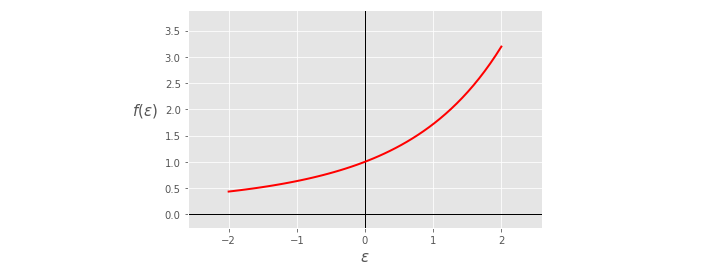

In [5]:
# create function
epsilon = np.linspace(-2,2)
f = (np.exp(epsilon) - 1)/epsilon

# reshape and package for plotter
epsilon.shape = (len(epsilon),1)
f.shape = (len(f),1)
f_table = np.concatenate((epsilon,f),axis=1)

# use custom plotter to plot function table of values
baslib.basics_plotter.single_plot(table = f_table,xlabel = '$\epsilon$',ylabel = '$f(\epsilon)$',rotate_ylabel=0)

#### <span style="color:#a50e3e;">Example. </span> Derivative the natural logarithm 

For this example we must use several properties of the (natural) logarithm - that is log the Euler base $e$ = 2.2.71828... - which include the following for positive constants $a$ and $b$

$$ \text{log}(a)-\text{log}(b) = \text{log}\left(\frac{a}{b}\right)$$

$$ a\cdot \text{log}(b) = \text{log}(b^a)$$

In addition we need to use one particular definition of Euler's constant

$$ \underset{\epsilon\rightarrow0}{\text{lim}} \,\,\left(1 + \epsilon \right)^{\frac{1}{\epsilon}} = e $$

(which can be verified by examining the plot of $f(\epsilon ) =\left(1 + \epsilon \right)^{\frac{1}{\epsilon}}$ in the printout of the next Python cell) and what follows in general that

$$ \left(1 + \epsilon w \right)^{\frac{1}{\epsilon}} = e^w $$

as $\epsilon$ becomes infinitely small.

Finally we need the fact that the natural log and $e$ are inverses of one another, e.g., that $\text{log}(e^w) = w$

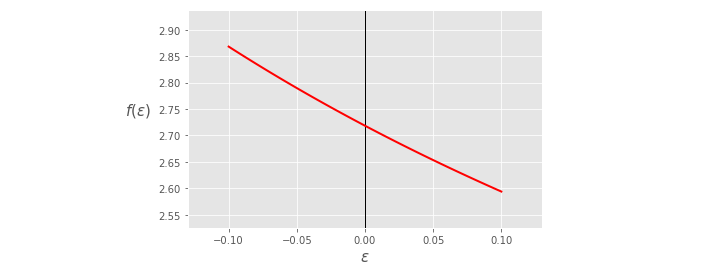

In [6]:
# create function
epsilon = np.linspace(-0.1,0.1)
f = (1 + epsilon)**(1/epsilon)

# reshape and package for plotter
epsilon.shape = (len(epsilon),1)
f.shape = (len(f),1)
f_table = np.concatenate((epsilon,f),axis=1)

# use custom plotter to plot function table of values
baslib.basics_plotter.single_plot(table = f_table,xlabel = '$\epsilon$',ylabel = '$f(\epsilon)$',rotate_ylabel = 0)

With these facts in mind and $g(w) = \text{log}(w)$ we have from the definition of the derivative we have 

$$\frac{\text{log}(w + \epsilon) - \text{log}(w)}{\epsilon} = \frac{\text{log}(\frac{w+\epsilon}{w})}{\epsilon} = \frac{\text{log}(1 + \frac{\epsilon}{w})}{\epsilon}= \text{log}((1 + \frac{\epsilon}{w})^\frac{1}{\epsilon})$$

And $\epsilon$ becomes infinitely small, using the definition of $e$, we have that the above

$$ =\text{log}(e^\frac{1}{w}) = \frac{1}{w} = \frac{\mathrm{d}}{\mathrm{d}w}g(w)$$

#### <span style="color:#a50e3e;">Example. </span> Derivative of sine

Using the 'double angle' rule $\text{sin}(a + b) = \text{sin}(a)\text{cos}(b) + \text{cos}(a)\text{sin}(b)$ we can write

$$
\frac{\text{sin}(w + \epsilon) - \text{sin}(w)}{\epsilon} = \frac{\text{sin}(w)\text{cos}(\epsilon) + \text{cos}(w)\text{sin}(\epsilon) - \text{sin}(w)}{\epsilon}$$

and re-arranging this we have that

$$= \text{sin}(w)\frac{(\text{cos}(\epsilon) - 1)}{\epsilon} + \text{cos}(w)\frac{\text{sin}(\epsilon)}{\epsilon} = \text{cos}(w)
$$

where the final equality follows from the facts that if we denote $f_1(\epsilon) = \frac{\text{cos}(\epsilon) - 1}{\epsilon}$  and  $f_2(\epsilon) = \frac{\text{sin}(\epsilon)}{\epsilon}$ then $f_1(\epsilon) = 0$ and $f_2(\epsilon) = 1$ as can be verified by examining the plot of each of these functions in the printout of the next Python cell. 

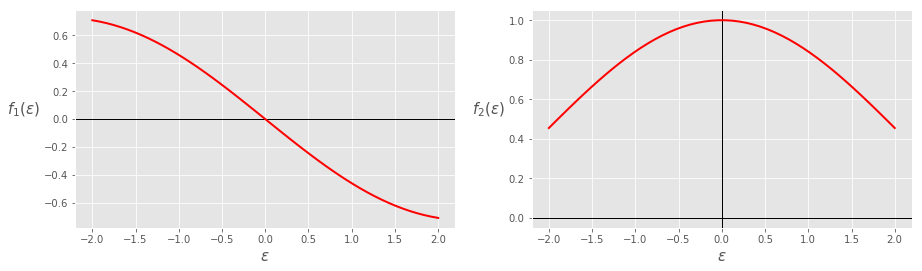

In [7]:
# create function
epsilon = np.linspace(-2,2)
f_1 = (np.cos(epsilon) - 1)/epsilon
f_2 = (np.sin(epsilon))/epsilon

# reshape and package for plotter
epsilon.shape = (len(epsilon),1)
f_1.shape = (len(f_1),1)
f_2.shape = (len(f_2),1)
f_1_table = np.concatenate((epsilon,f_1),axis=1)
f_2_table = np.concatenate((epsilon,f_2),axis=1)

# use custom plotter to plot function table of values
baslib.basics_plotter.double_plot(table1 = f_1_table,table2 = f_2_table,xlabel = '$\epsilon$',ylabel_1 = '$f_1(\epsilon)$',ylabel_2 = '$f_2(\epsilon)$')

## 2.2 Derivative rules

Using the same general definition of the derivative at a point we can derive all of the rules listed in Table 2.

### Scalar multiplication rule

If $c$ is just a constant, then we have from the definition of the derivative $\frac{\mathrm{d}}{\mathrm{d} w}\left(c \cdot g(w)\right)$ that we can simply factor the constant out, giving

\begin{equation}
 \frac{c\cdot g(w + \epsilon) - c\cdot g(w)}{\epsilon} = c \cdot\frac{g(w + \epsilon) - g(w)}{\epsilon} 
\end{equation}

and as $\epsilon$ vanishes the right hand side is precisely $c\cdot\frac{\mathrm{d}}{\mathrm{d} w} g(w)$

### Addition rule

To show that the derivative of a sum is the sum of individual derivatves, we start by computing the derivative of $\frac{\mathrm{d}}{\mathrm{d}w}\left(f(w) + g(w) \right)$ for small $\epsilon$, and simply rearrange terms as 

$$
\frac{\left(f(w + \epsilon) + g(w + \epsilon)\right) - \left(f(w) + g(w)\right)}{\epsilon} 
$$

\begin{equation}
= \frac{f(w + \epsilon) - f(w)}{\epsilon}  + \frac{g(w + \epsilon) - g(w)}{\epsilon} 
\end{equation}

with the latter being precisely $\frac{\mathrm{d}}{\mathrm{d}w}f(w) + \frac{\mathrm{d}}{\mathrm{d}w}g(w)$

### Product rule

With two functions $f(w)$ and $g(w)$ the definition of the derivative for small magnitude $\epsilon$ gives

$$\frac{f(w + \epsilon)g(w + \epsilon) - f(w)g(w)}{\epsilon} $$

Adding and subtracting $f(w+\epsilon)g(w)$ (equals zero)

$$=\frac{f(w + \epsilon)g(w + \epsilon) - f(w + \epsilon)g(w) + f(w+\epsilon)g(w) - f(w)g(w)}{\epsilon} $$

$$=\frac{f(w + \epsilon) - f(w)}{\epsilon}\,g(w) \, \,+ \,\, f(w + \epsilon)\,\frac{g(w + \epsilon) - g(w)}{\epsilon}$$

Then as $\epsilon \longrightarrow 0$ we have that

$\begin{align}
f(w + \epsilon) \longrightarrow f(w)~~~~~~\\ 
\frac{f(w + \epsilon) - f(w)}{\epsilon}\longrightarrow \frac{\mathrm{d}}{\mathrm{d}w}f(w)  \\
\frac{g(w + \epsilon) - g(w)}{\epsilon}\longrightarrow \frac{\mathrm{d}}{\mathrm{d}w}g(w)  \\
\end{align}$

And so all together then the above gives $\frac{\mathrm{d}}{\mathrm{d}w}f(w)\cdot g(w) + f(w)\cdot\frac{\mathrm{d}}{\mathrm{d}w}g(w)$

### Chain rule

With two functions $f(w)$ and $g(w)$ lets look at the composition $f(g(w))$ and compute its derivative $\frac{\mathrm{d}}{\mathrm{d}w}(f(g(w)))$ at a general input $w$.  For small magnitude $\epsilon$ the definition of the derivative gives


$$
\frac{f(g(w + \epsilon)) - f(g(w))}{\epsilon} = \frac{f(g(w + \epsilon)) - f(g(w))}{g(w + \epsilon) - g(w)} \cdot \frac{g(w + \epsilon) - g(w)}{\epsilon} 
$$

As $\vert{\epsilon}\vert \longrightarrow 0$ the left hand side above becomes $\frac{\mathrm{d}}{\mathrm{d}w}(f(g(w)))$, but so too does $g(w + \epsilon) - g(w) \longrightarrow 0 $ and on the right side we have that 

$$
\frac{f(g(w + \epsilon)) - f(g(w))}{g(w + \epsilon) - g(w)} \longrightarrow \frac{\mathrm{d}}{\mathrm{d}g}f(g)
$$
$\,\,\,$
$$
~~~~~~~~~~~\frac{g(w + \epsilon) - g(w)}{\epsilon} \longrightarrow \frac{\mathrm{d}}{\mathrm{d}w}g(w)
$$

Therefore all together we have that

$$\frac{\mathrm{d}}{\mathrm{d}w}(f(g(w)))= \frac{\mathrm{d}}{\mathrm{d}g}f(g) \cdot \frac{\mathrm{d}}{\mathrm{d}w}g(w)$$

<a id='endnotes'></a>
## Endnotes

[1]   If you took a calculus course in school you may have - depending on your luck - spent much of your time there being forced to apply these simple rules over and over again, computing derivative equations of increasingly complicated examples of elementary functions combinations like this one.  No need to re-live those terrors if we can avoid them.  The point here is to recognize the fact that - if performed procedurally by first decomposing the function, then applying the derivative rules and formula, etc., - computing derivatives is a very automatable seeming task.

<blockquote style="border-left: 5px solid; border-left-color: #ccc; background: white;"><p>The content of this notebook is supplementary material for the textbook Machine Learning Refined (Cambridge University Press, 2016). Visit <a href="http://mlrefined.com">http://mlrefined.com</a> for free chapter downloads and tutorials, and <a href="https://www.amazon.com/Machine-Learning-Refined-Foundations-Applications/dp/1107123526/ref=sr_1_1?ie=UTF8&amp;qid=1474491657&amp;sr=8-1&amp;keywords=machine+learning+refined">our Amazon site</a> for details regarding a hard copy of the text.</p>
</blockquote>